# **SAM on brightfield**

Segment anything model on brightfield of Paramecia for shape and area. \
In questo codice vogliamo creare un'interfaccia che elabori le immagini in sequenza (che risulta più semplice e affidabile) ma con un processo automatizzato. In particolare gli step consistono in:

- Caricare tutte le immagini TIF da una cartella
- Selezionare i punti per ogni immagine
- Generare e salvare le maschere risultanti

## **Single tif file code**

Original image range: 1536.0 to 4095.0
Image shape: (1024, 1024)


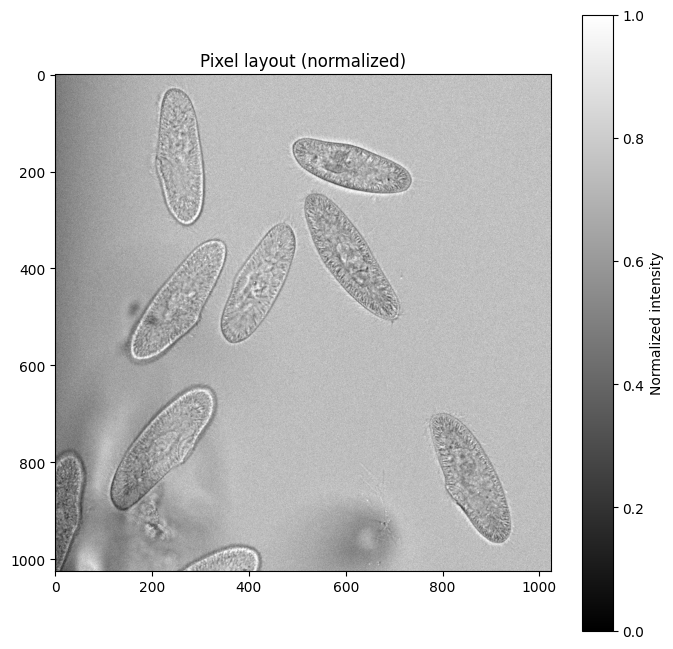

Converting grayscale image to RGB...
RGB image shape: (1024, 1024, 3)
(1024, 1024)


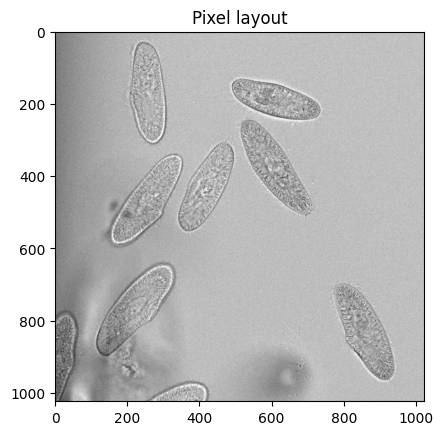

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import torch
import os
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor

path = "z:\\Users\\Benedetta\\3. IF imaging and analysis\\Testing\\"

#Open a tif file
im = Image.open(path+"PHEMfix_Control_009.tif")
#im_array = np.array(im.convert("RGB"))

# Convert to numpy array with explicit dtype and ensure it's in the native byte order
im_array_raw = np.asarray(im, dtype=np.float32).copy()  # Create a copy with native byte order

# Print the min and max values to understand the data range
print(f"Original image range: {im_array_raw.min()} to {im_array_raw.max()}")

# Normalize for display (0-1 range for floats)
im_array = (im_array_raw - im_array_raw.min()) / (im_array_raw.max() - im_array_raw.min())

# Get the shape of the array
print(f"Image shape: {im_array_raw.shape}")

# Display the normalized image
plt.figure(figsize=(8, 8))
plt.imshow(im_array, cmap='gray')
plt.title("Pixel layout (normalized)")
plt.colorbar(label="Normalized intensity")
plt.show()

# Check if grayscale (1 channel) and convert to RGB (3 channels) for the model
if len(im_array_raw.shape) == 2:
    print("Converting grayscale image to RGB...")
    # For display purposes, normalize to 0-255 range and convert to uint8
    im_array_uint8 = (im_array * 255).astype(np.uint8)
    # Convert grayscale to RGB by repeating the channel 3 times
    im_array_rgb = np.stack([im_array_uint8, im_array_uint8, im_array_uint8], axis=2)
    print(f"RGB image shape: {im_array_rgb.shape}")
elif len(im_array_raw.shape) == 3 and im_array_raw.shape[2] == 1:
    print("Converting single-channel image to RGB...")
    im_array_uint8 = (im_array * 255).astype(np.uint8)
    im_array_rgb = np.concatenate([im_array_uint8, im_array_uint8, im_array_uint8], axis=2)
    print(f"RGB image shape: {im_array_rgb.shape}")
else:
    # Already RGB or multi-channel
    im_array_uint8 = (im_array * 255).astype(np.uint8)
    im_array_rgb = im_array_uint8
    print(f"Using existing multi-channel image: {im_array_rgb.shape}")


#Convert to numpy array
#im_array = np.array(im)
#Get the shape of the array
print(im_array.shape)

plt.imshow(im_array, cmap='gray')
plt.title("Pixel layout")
plt.show()


In [38]:
np.random.seed(3)

def show_mask(mask, ax, random_color=False, borders = True):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask = mask.astype(np.uint8)
    mask_image =  mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if borders:
        import cv2
        contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
        # Try to smooth contours
        contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
        mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2) 
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))    

def show_masks(image, masks, scores, point_coords=None, box_coords=None, input_labels=None, borders=True):
    for i, (mask, score) in enumerate(zip(masks, scores)):
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        show_mask(mask, plt.gca(), borders=borders)
        if point_coords is not None:
            assert input_labels is not None
            show_points(point_coords, input_labels, plt.gca())
        if box_coords is not None:
            # boxes
            show_box(box_coords, plt.gca())
        if len(scores) > 1:
            plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
        plt.axis('off')
        plt.show()

# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")


if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )
sam2_checkpoint = "./checkpoints/sam2.1_hiera_large.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_l.yaml"

sam2_model = build_sam2(model_cfg, sam2_checkpoint, device=device)

predictor = SAM2ImagePredictor(sam2_model)
predictor.set_image(im_array_rgb)

using device: cpu


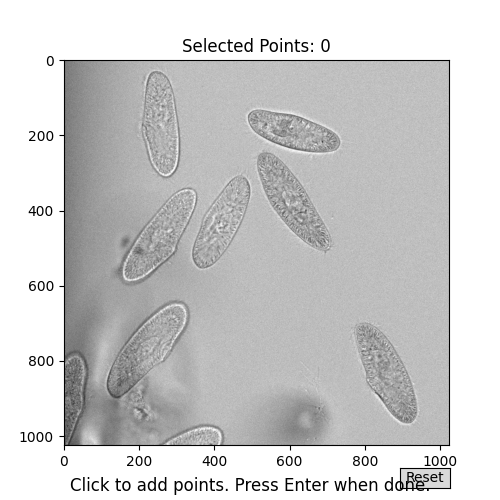

In [42]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Button
from IPython.display import display, clear_output

# Enable interactive matplotlib widgets in Jupyter
%matplotlib widget

class PointSelector:
    def __init__(self, image):
        self.image = image
        self.points = []
        self.labels = []  # Default label is 1
        self.fig_created = False
        self.setup_figure()
        
    def setup_figure(self):
        # Create figure and display image
        self.fig, self.ax = plt.subplots(figsize=(5, 5))
        self.ax.imshow(self.image)
        
        # Add instruction text
        self.fig.text(0.5, 0.01, 'Click to add points. Press Enter when done.', 
                     ha='center', va='bottom', fontsize=12)
        
        # Connect event handlers
        self.fig.canvas.mpl_connect('button_press_event', self.on_click)
        self.fig.canvas.mpl_connect('key_press_event', self.on_key)
        
        # Add reset button
        ax_reset = plt.axes([0.8, 0.025, 0.1, 0.04])
        self.reset_button = Button(ax_reset, 'Reset')
        self.reset_button.on_clicked(self.reset)
        
        self.ax.set_title(f'Selected Points: {len(self.points)}')
        plt.axis('on')
        self.fig_created = True
        
    def on_click(self, event):
        # Ignore clicks outside the image
        if event.inaxes != self.ax:
            return
            
        # Add the point
        x, y = int(event.xdata), int(event.ydata)
        self.points.append([x, y])
        self.labels.append(1)  # Default label is 1
        
        # Update visualization
        self.show_points()
        
    def on_key(self, event):
        if event.key == 'enter':
            # In Jupyter, we don't want to close the figure
            # Just signal that we're done
            clear_output(wait=True)
            print(f"Selection complete! {len(self.points)} points selected.")
            self.done = True
            
    def reset(self, event):
        self.points = []
        self.labels = []
        self.ax.clear()
        self.ax.imshow(self.image)
        self.ax.set_title(f'Selected Points: {len(self.points)}')
        plt.draw()
            
    def show_points(self):
        # Clear and redraw image
        self.ax.clear()
        self.ax.imshow(self.image)
        
        # Plot points
        points_array = np.array(self.points)
        if len(points_array) > 0:
            self.ax.scatter(
                points_array[:, 0],
                points_array[:, 1],
                color='red',
                marker='*',
                s=200,
                edgecolor='white',
                linewidth=1.25
            )
            
        self.ax.set_title(f'Selected Points: {len(self.points)}')
        plt.draw()
        
    def get_points(self):
        return np.array(self.points), np.array(self.labels)

def show_points(coords, labels, ax):
    """Show points on the image."""
    pos_points = coords[labels == 1]
    neg_points = coords[labels == 0]
    
    ax.scatter(
        pos_points[:, 0],
        pos_points[:, 1],
        color='green',
        marker='*',
        s=200,
        edgecolor='white',
        linewidth=1.25
    )
    ax.scatter(
        neg_points[:, 0],
        neg_points[:, 1],
        color='red',
        marker='*',
        s=200,
        edgecolor='white',
        linewidth=1.25
    )

# Example
# Create the point selector
selector = PointSelector(im_array_rgb)

Selected points:
[[255 167]
 [593 196]
 [263 449]
 [401 422]
 [614 358]
 [843 824]]
Switched to static display mode


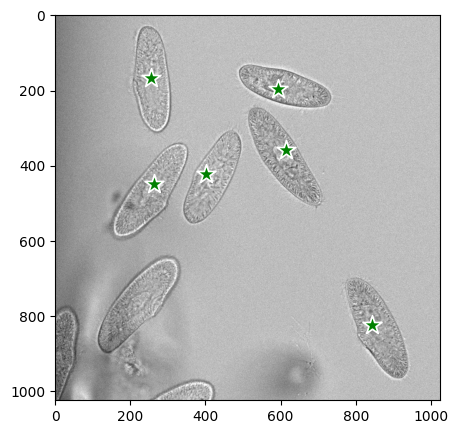

In [43]:
# Get the points after selection (run this cell after selecting points)
input_point, input_label = selector.get_points()
print(f"Selected points:\n{input_point}")

# Close all figures to clean up
plt.close('all')

# Switch to inline mode for static display
%matplotlib inline
print("Switched to static display mode")

# Visualize the final selected points if needed
plt.figure(figsize=(5, 5))
plt.imshow(im_array_rgb)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

torch.Size([1, 256, 64, 64]) torch.Size([256, 64, 64])
Masks shape: (3, 1024, 1024)


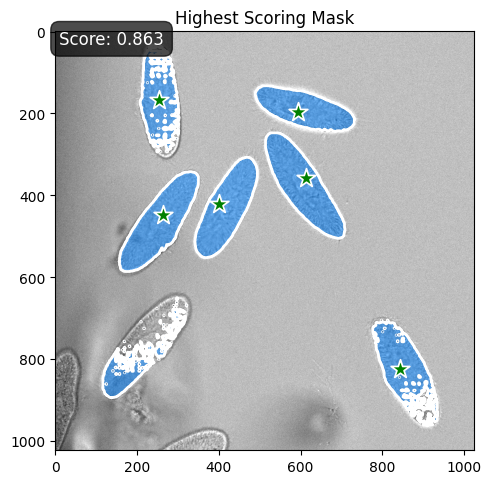

In [44]:
# Function to show a single mask with score
def show_single_mask(image, mask, score, point_coords=None, point_labels=None):
    """
    Display only the first (highest-scoring) mask with its score
    
    Parameters:
    - image: The original image
    - mask: Single binary mask (H x W)
    - score: Confidence score for the mask
    - point_coords: Optional points to overlay
    - point_labels: Labels for the points
    """
    plt.figure(figsize=(5, 5))
    
    # Display the image
    plt.imshow(image)
    
    # Add mask as a transparent overlay with border
    color = np.array([30/255, 144/255, 255/255, 0.6])  # Light blue, semi-transparent
    h, w = mask.shape[-2:]
    mask_img = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    
    plt.imshow(mask_img)
    
    # Add contour for the mask boundary
    if mask.sum() > 0:  # Only draw contour if mask is not empty
        contours = plt.contour(mask, 
                             levels=[0.5], 
                             colors=['white'],
                             linewidths=2)
    
    # Add points if provided
    if point_coords is not None and point_labels is not None:
        show_points(point_coords, point_labels, plt.gca())
    
    # Add score as text in the upper left
    plt.annotate(
        f"Score: {score:.3f}",
        (10, 30),
        color='white',
        fontsize=12,
        bbox=dict(boxstyle="round,pad=0.5", fc="black", alpha=0.7)
    )
    
    plt.title("Highest Scoring Mask")
    plt.tight_layout()
    plt.axis('on')
    plt.show()

# After running your predictor code:
print(predictor._features["image_embed"].shape, predictor._features["image_embed"][-1].shape)
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

# Sort masks by score
sorted_ind = np.argsort(scores)[::-1]
masks = masks[sorted_ind]
scores = scores[sorted_ind]
logits = logits[sorted_ind]

print(f"Masks shape: {masks.shape}")  # (number_of_masks) x H x W

# Display only the first (highest-scoring) mask with its score
show_single_mask(
    image=im_array_rgb, 
    mask=masks[0],  # Just the first mask
    score=scores[0],  # Its corresponding score
    point_coords=input_point, 
    point_labels=input_label
)

## **Generalization to batch of tif files**

**Importazione di librerie e setup**

In [26]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.widgets import Button
from PIL import Image
import torch
import os
import glob
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor
from IPython.display import display, clear_output
import cv2
from tqdm import tqdm

# Path to the directory containing TIF files
path = "z:\\Shared\\Benedetta_shared\\Cell analysis\\"
output_path = os.path.join(path, "results")

# Create output directory if it doesn't exist
if not os.path.exists(output_path):
    os.makedirs(output_path)


**Definizione delle opportune funzioni di visualizzazione, processione e della classe PointSelector**

In [43]:
from IPython.display import HTML, display
from IPython import get_ipython

# Function to show mask
def show_mask(mask, ax, random_color=False, borders=True):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask = mask.astype(np.uint8)
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if borders:
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
        # Try to smooth contours
        contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
        mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2) 
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)   

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))  

# Function to show a single mask with score
def show_single_mask(image, mask, score, point_coords=None, point_labels=None):
    """
    Display only the first (highest-scoring) mask with its score
    
    Parameters:
    - image: The original image
    - mask: Single binary mask (H x W)
    - score: Confidence score for the mask
    - point_coords: Optional points to overlay
    - point_labels: Labels for the points
    """
    plt.figure(figsize=(5, 5))
    
    # Display the image
    plt.imshow(image)
    
    # Add mask as a transparent overlay with border
    color = np.array([30/255, 144/255, 255/255, 0.6])  # Light blue, semi-transparent
    h, w = mask.shape[-2:]
    mask_img = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    
    plt.imshow(mask_img)
    
    # Add contour for the mask boundary
    if mask.sum() > 0:  # Only draw contour if mask is not empty
        contours = plt.contour(mask, 
                             levels=[0.5], 
                             colors=['white'],
                             linewidths=2)
    
    # Add points if provided
    if point_coords is not None and point_labels is not None:
        show_points(point_coords, point_labels, plt.gca())
    
    # Add score as text in the upper left
    plt.annotate(
        f"Score: {score:.3f}",
        (10, 30),
        color='white',
        fontsize=12,
        bbox=dict(boxstyle="round,pad=0.5", fc="black", alpha=0.7)
    )
    
    plt.title("Highest Scoring Mask")
    plt.tight_layout()
    plt.axis('on')
    plt.show()

# Point selector class for interactive point selection
class PointSelector:
    def __init__(self, image, image_name):
        self.image = image
        self.image_name = image_name
        self.points = []
        self.labels = []  # Default label is 1
        self.fig_created = False
        self.done = False
        self.setup_figure()
        
    def setup_figure(self):
        # Create figure and display image
        self.fig, self.ax = plt.subplots(figsize=(5, 5))
        self.ax.imshow(self.image, cmap='gray')
        
        # Add instruction text
        self.fig.text(0.5, 0.02, 'Left-click: Add positive point (green) | Right-click: Add negative point (red) | Press Enter when done', 
                     ha='center', va='bottom', fontsize=10)
        
        # Connect event handlers
        self.fig.canvas.mpl_connect('button_press_event', self.on_click)
        self.fig.canvas.mpl_connect('key_press_event', self.on_key)
        
        # Add reset button
        ax_reset = plt.axes([0.8, 0.025, 0.1, 0.04])
        self.reset_button = Button(ax_reset, 'Reset')
        self.reset_button.on_clicked(self.reset)
        
        self.ax.set_title(f'Image: {self.image_name}\nSelected Points: {len(self.points)}')
        plt.axis('on')
        self.fig_created = True
        
    def on_click(self, event):
        # Ignore clicks outside the image
        if event.inaxes != self.ax:
            return
            
        # Add the point
        x, y = int(event.xdata), int(event.ydata)
        self.points.append([x, y])
        
        # Left button: positive point (1), right button: negative point (0)
        if event.button == 1:  # Left click
            self.labels.append(1)
        elif event.button == 3:  # Right click
            self.labels.append(0)
        
        # Update visualization
        self.show_points()
        
    def on_key(self, event):
        if event.key == 'enter':
            plt.close(self.fig)
            self.done = True
            
    def reset(self, event):
        self.points = []
        self.labels = []
        self.ax.clear()
        self.ax.imshow(self.image, cmap='gray')
        self.ax.set_title(f'Image: {self.image_name}\nSelected Points: {len(self.points)}')
        plt.draw()
            
    def show_points(self):
        # Clear and redraw image
        self.ax.clear()
        self.ax.imshow(self.image, cmap='gray')
        
        # Plot points
        if len(self.points) > 0:
            points_array = np.array(self.points)
            labels_array = np.array(self.labels)
            
            pos_points = points_array[labels_array == 1]
            neg_points = points_array[labels_array == 0]
            
            if len(pos_points) > 0:
                self.ax.scatter(
                    pos_points[:, 0],
                    pos_points[:, 1],
                    color='green',
                    marker='*',
                    s=200,
                    edgecolor='white',
                    linewidth=1.25
                )
            
            if len(neg_points) > 0:
                self.ax.scatter(
                    neg_points[:, 0],
                    neg_points[:, 1],
                    color='red',
                    marker='*',
                    s=200,
                    edgecolor='white',
                    linewidth=1.25
                )
            
        self.ax.set_title(f'Image: {self.image_name}\nSelected Points: {len(self.points)} (Positive: {sum(self.labels)}, Negative: {len(self.labels)-sum(self.labels)})')
        plt.draw()
        
    def get_points(self):
        return np.array(self.points), np.array(self.labels)

# Cella 6: Funzione per elaborare più immagini in batch
def batch_process_images():
    """Process all TIF images in the specified directory"""
    # Get all TIF files in the directory
    tif_files = glob.glob(os.path.join(path, "*.tif"))
    
    if not tif_files:
        print(f"No TIF files found in {path}")
        return
    
    print(f"Found {len(tif_files)} TIF files")
    
    # Ask user if they want to process all images or select specific ones
    print("\nOptions:")
    print("1. Process all images")
    print("2. Select specific images")
    choice = input("Enter your choice (1 or 2): ")
    
    if choice == "2":
        # Display list of files for selection
        for i, file in enumerate(tif_files):
            print(f"{i+1}. {os.path.basename(file)}")
        
        # Get user selection
        selection = input("Enter the numbers of images to process (comma-separated, e.g., 1,3,5): ")
        selected_indices = [int(idx.strip()) - 1 for idx in selection.split(",")]
        selected_files = [tif_files[i] for i in selected_indices if 0 <= i < len(tif_files)]
    else:
        selected_files = tif_files
    
    print(f"\nWill process {len(selected_files)} images")
    
    # Initialize results list
    results = []
    
    # Process each selected image
    for image_path in selected_files:
        result = process_single_image(image_path)
        if result:
            results.append(result)
    
    # Create summary of results
    if results:
        print("\n----- SUMMARY -----")
        print(f"Processed {len(results)} images")
        
        # Create a summary dataframe and save as CSV
        summary = pd.DataFrame([{
            'image_name': r['image_name'],
            'mask_score': r['score'],
            'mask_pixels': r['mask_pixels'],
            'mask_percentage': r['mask_percentage']
        } for r in results])
        
        # Display summary
        print("\nResults summary:")
        print(summary)
        
        return summary  # Return the summary dataframe for further analysis if needed
    
    return None


In [45]:
# Funzione process_single_image corretta
def process_single_image(image_path):
    """Process a single image with SAM2 model"""
    # Get just the filename without extension
    image_filename = os.path.basename(image_path)
    image_name = os.path.splitext(image_filename)[0]
    
    print(f"\nProcessing image: {image_filename}")
    
    # Load the image
    im = Image.open(image_path)
    im_array = np.array(im)
    
    # Make sure we're starting with interactive mode off
    plt.ioff()
    
    # Display image (non-interactive preview)
    plt.figure(figsize=(5, 5))
    plt.imshow(im_array, cmap='gray')
    plt.title(f"Image: {image_filename}")
    plt.show()
    plt.close()
    
    # Now start interactive mode for point selection
    plt.ion()
    
    try:
        # Use the point selector to select points
        selector = PointSelector(im_array, image_name)
        
        # Wait for the selection to be done
        while not selector.done:
            plt.pause(0.5)  # Increased pause time for better responsiveness
            if not plt.fignum_exists(selector.fig.number):
                # Figure was closed without pressing Enter
                selector.done = True
        
        # Get selected points
        input_point, input_label = selector.get_points()
        
        # If no points were selected, skip this image
        if len(input_point) == 0:
            print(f"No points selected for {image_filename}. Skipping...")
            return None
        
        print(f"Selected {len(input_point)} points for {image_filename}")
        
        # Set image for SAM model
        predictor.set_image(im_array)
        
        # Predict mask
        masks, scores, logits = predictor.predict(
            point_coords=input_point,
            point_labels=input_label,
            multimask_output=True,
        )
        
        # Sort masks by score
        sorted_ind = np.argsort(scores)[::-1]
        masks = masks[sorted_ind]
        scores = scores[sorted_ind]
        
        # Turn off interactive mode before displaying results
        plt.ioff()
        
        # Display best mask
        show_single_mask(
            image=im_array, 
            mask=masks[0],  # Just the first mask
            score=scores[0],  # Its corresponding score
            point_coords=input_point, 
            point_labels=input_label
        )
        
        # Calculate and display mask area
        mask_pixels = masks[0].sum()
        total_pixels = masks[0].size
        mask_percentage = (mask_pixels / total_pixels) * 100
        
        print(f"Mask area: {mask_pixels} pixels")
        print(f"Percentage of image: {mask_percentage:.2f}%")
        
        # Save results
        result = {
            'image_name': image_name,
            'mask': masks[0],
            'score': scores[0],
            'points': input_point,
            'labels': input_label,
            'mask_pixels': mask_pixels,
            'mask_percentage': mask_percentage
        }
        
        # Save mask as an image
        mask_img = masks[0].astype(np.uint8) * 255
        mask_filename = os.path.join(output_path, f"{image_name}_mask.png")
        cv2.imwrite(mask_filename, mask_img)
        
        # Save visualization
        plt.figure(figsize=(10, 5))
        
        # Original image with points
        plt.subplot(1, 2, 1)
        plt.imshow(im_array, cmap='gray')
        show_points(input_point, input_label, plt.gca())
        plt.title("Original with Points")
        
        # Masked image
        plt.subplot(1, 2, 2)
        plt.imshow(im_array, cmap='gray')
        color_mask = np.zeros((im_array.shape[0], im_array.shape[1], 4), dtype=np.float32)
        color_mask[masks[0] == 1] = [30/255, 144/255, 255/255, 0.6]
        plt.imshow(color_mask)
        plt.title(f"Mask (Score: {scores[0]:.3f})")
        
        plt.tight_layout()
        vis_filename = os.path.join(output_path, f"{image_name}_visualization.png")
        plt.savefig(vis_filename)
        plt.close()
        
        print(f"Results saved to {output_path}")
        
        return result
    finally:
        # Make sure interactive mode is turned off before exiting function
        plt.ioff()

In [ ]:
#DO NOT RUN THIS CELL
# Function to process a single image
def process_single_image(image_path):
    """Process a single image with SAM2 model"""
    # Get just the filename without extension
    image_filename = os.path.basename(image_path)
    image_name = os.path.splitext(image_filename)[0]
    
    print(f"\nProcessing image: {image_filename}")
    
    # Load the image
    im = Image.open(image_path)
    im_array = np.array(im)
    
    # Display image
    plt.figure(figsize=(5, 5))
    plt.imshow(im_array, cmap='gray')
    plt.title(f"Image: {image_filename}")
    plt.show()
    plt.close()

    
    # Ensure matplotlib is in interactive mode
    plt.ion()
    # Use the point selector to select points
    selector = PointSelector(im_array, image_name)

    # Use IPython's display to show a message
    from IPython.display import display, clear_output
    display(HTML("<p>Please select points and press Enter when done</p>"))
    
    # Wait for the selection to be done
    # This attribute will be set to True in the on_key method when Enter is pressed
    selector.done = False
    
    # Wait for the selection to be done
    while not selector.done:
        plt.pause(10)  # Increased pause time for better responsiveness
        if not plt.fignum_exists(selector.fig.number):
            # Figure was closed without pressing Enter
            selector.done = True
    
    # Get selected points
    input_point, input_label = selector.get_points()
    print(f"Selected points:\n{input_point}")
    plt.ioff()  # Turn off interactive mode
    plt.close('all')

    # Switch to inline mode for static display
    get_ipython().run_line_magic('matplotlib', 'inline')
    print("Switched to static display mode")

    # If no points were selected, skip this image
    if len(input_point) == 0:
        print(f"No points selected for {image_filename}. Skipping...")
        return None
    
    print(f"Selected {len(input_point)} points for {image_filename}")
    
    # Set image for SAM model
    predictor.set_image(im_array)
    
    # Predict mask
    masks, scores, logits = predictor.predict(
        point_coords=input_point,
        point_labels=input_label,
        multimask_output=True,
    )
    
    # Sort masks by score
    sorted_ind = np.argsort(scores)[::-1]
    masks = masks[sorted_ind]
    scores = scores[sorted_ind]
    
    # Display best mask
    show_single_mask(
        image=im_array, 
        mask=masks[0],  # Just the first mask
        score=scores[0],  # Its corresponding score
        point_coords=input_point, 
        point_labels=input_label
    )
    
    # Calculate and display mask area
    mask_pixels = masks[0].sum()
    total_pixels = masks[0].size
    mask_percentage = (mask_pixels / total_pixels) * 100
    
    print(f"Mask area: {mask_pixels} pixels")
    print(f"Percentage of image: {mask_percentage:.2f}%")
    
    # Save results
    result = {
        'image_name': image_name,
        'mask': masks[0],
        'score': scores[0],
        'points': input_point,
        'labels': input_label,
        'mask_pixels': mask_pixels,
        'mask_percentage': mask_percentage
    }
    
    # Save mask as an image
    mask_img = masks[0].astype(np.uint8) * 255
    mask_filename = os.path.join(output_path, f"{image_name}_mask.png")
    cv2.imwrite(mask_filename, mask_img)
    
    # Save visualization
    plt.figure(figsize=(10, 5))
    
    # Original image with points
    plt.subplot(1, 2, 1)
    plt.imshow(im_array, cmap='gray')
    show_points(input_point, input_label, plt.gca())
    plt.title("Original with Points")
    
    # Masked image
    plt.subplot(1, 2, 2)
    plt.imshow(im_array, cmap='gray')
    color_mask = np.zeros((im_array.shape[0], im_array.shape[1], 4), dtype=np.float32)
    color_mask[masks[0] == 1] = [30/255, 144/255, 255/255, 0.6]
    plt.imshow(color_mask)
    plt.title(f"Mask (Score: {scores[0]:.3f})")
    
    plt.tight_layout()
    vis_filename = os.path.join(output_path, f"{image_name}_visualization.png")
    plt.savefig(vis_filename)
    plt.close()
    
    print(f"Results saved to {output_path}")
    
    return result


**Setup del modello Sam2**

In [46]:
# Set up SAM2 model
# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"Using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )

# Load SAM2 model
sam2_checkpoint = "./checkpoints/sam2.1_hiera_large.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_l.yaml"

sam2_model = build_sam2(model_cfg, sam2_checkpoint, device=device)
predictor = SAM2ImagePredictor(sam2_model)

Using device: cpu


Elaborazione dell'immagine di esempio: Chan1_001_f1406.tif

Processing image: Chan1_001_f1406.tif


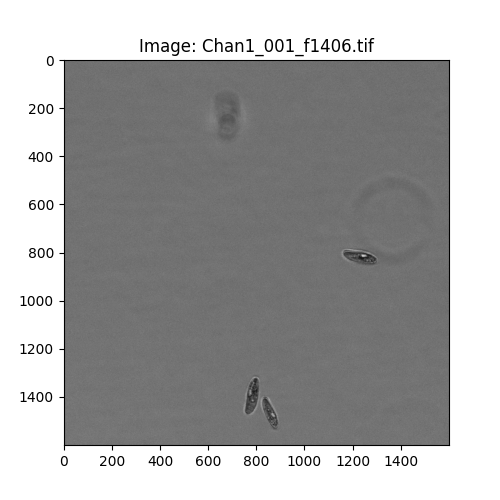

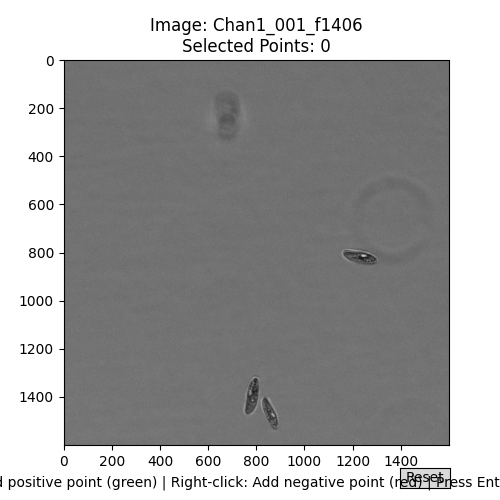

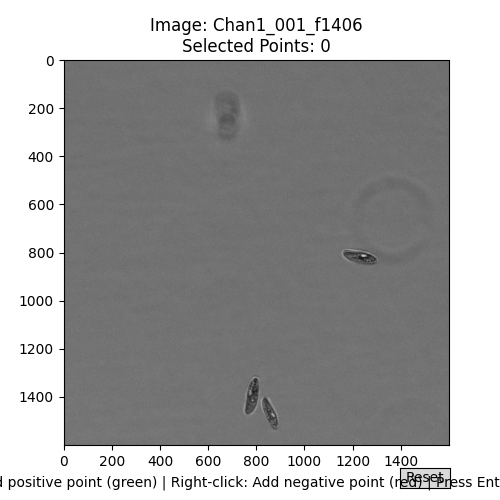

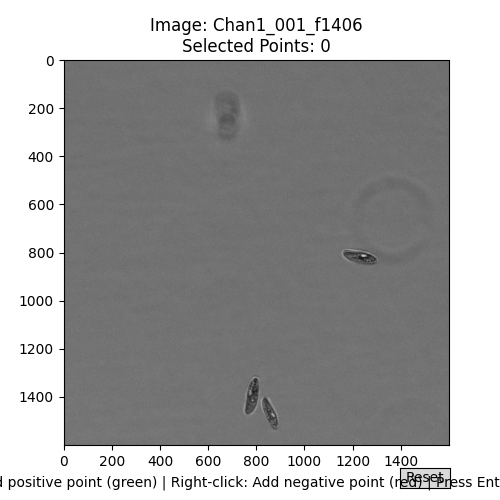

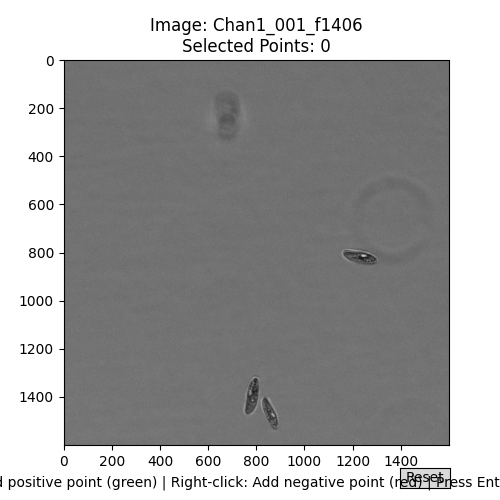

...

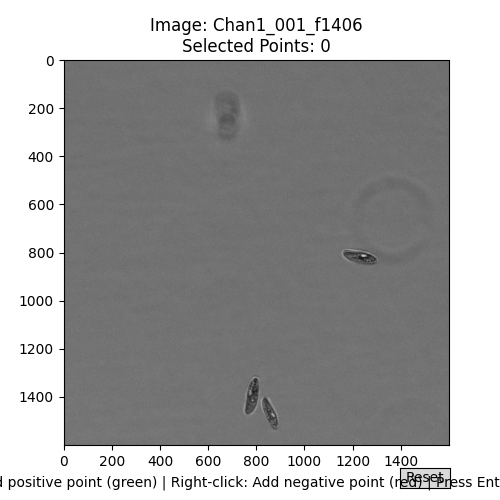

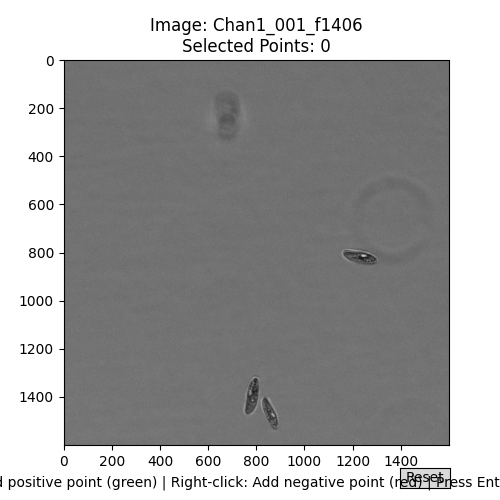

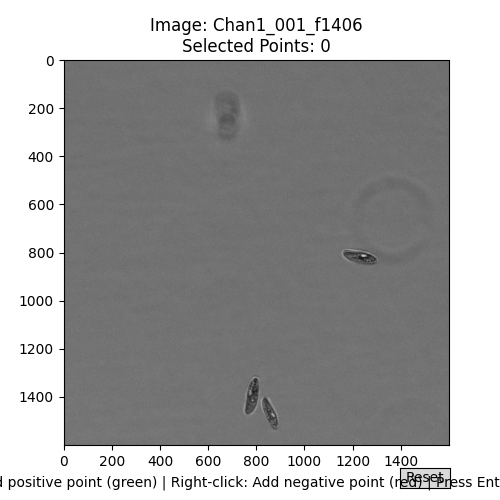

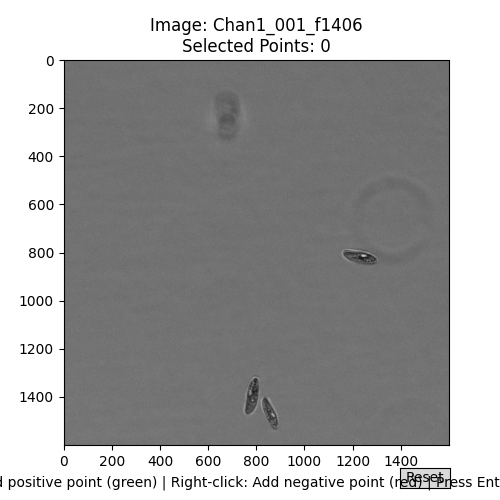

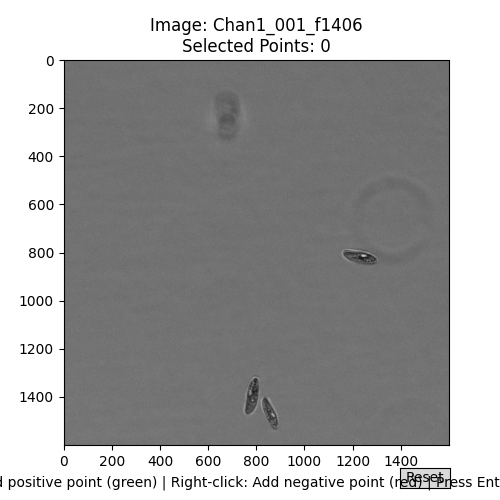

KeyboardInterrupt: 

In [47]:
example_image_path = os.path.join(path, "Chan1_001_f1406.tif")

# Verifica se l'immagine esiste
if os.path.exists(example_image_path):
    print(f"Elaborazione dell'immagine di esempio: {os.path.basename(example_image_path)}")
    example_result = process_single_image(example_image_path)
    if example_result:
        print("Elaborazione dell'immagine di esempio completata con successo!")
else:
    print(f"Immagine di esempio non trovata: {example_image_path}")
    print("Modifica il percorso con un'immagine TIF esistente nella tua cartella")

SAM2 Batch Processing for Brightfield Images
Found 8 TIF files

Options:
1. Process all images
2. Select specific images

Will process 8 images

Processing image: Chan1_002_f1600.tif


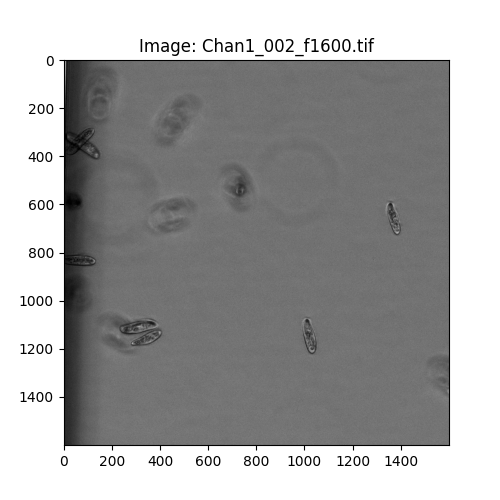

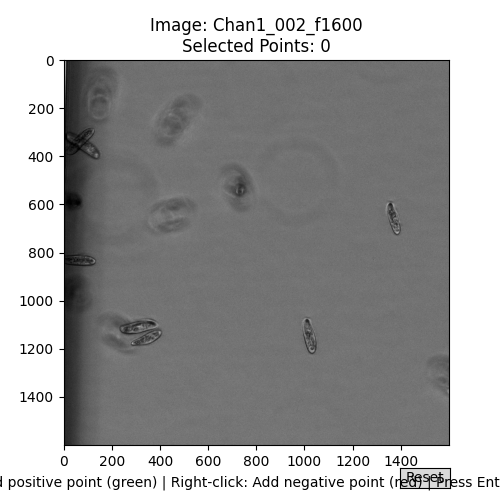

KeyboardInterrupt: 

In [33]:
#Batch elaboration
print("SAM2 Batch Processing for Brightfield Images")
results_summary = batch_process_images()

# Se vuoi analizzare ulteriormente i risultati, puoi farlo qui
if results_summary is not None:
    # Ad esempio, potresti voler visualizzare statistiche o grafici
    if len(results_summary) > 1:
        plt.figure(figsize=(10, 6))
        plt.bar(results_summary['image_name'], results_summary['mask_percentage'])
        plt.xlabel('Immagine')
        plt.ylabel('Percentuale di area coperta (%)')
        plt.title('Confronto delle aree delle maschere')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.savefig(os.path.join(output_path, "area_comparison.png"))
        plt.show()